In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/nfl-big-data-bowl-2024/players.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_7.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_9.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_6.csv
/kaggle/input/nfl-big-data-bowl-2024/games.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_8.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_4.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_3.csv
/kaggle/input/nfl-big-data-bowl-2024/tackles.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_5.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_1.csv
/kaggle/input/nfl-big-data-bowl-2024/plays.csv
/kaggle/input/nfl-big-data-bowl-2024/tracking_week_2.csv


# NFL Data Bowl 2024 - Plays Animation  

## Let us first import the Python libraries

In [2]:
import os
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import math
import scipy
from random import choice
from scipy.spatial.distance import euclidean
from scipy.special import expit
from IPython.display import HTML
from matplotlib import animation
from tqdm import tqdm
import glob

## Let us Load the data files

In [3]:
#train_df = pd.read_csv('../input/nfl-big-data-bowl-2024/tracking_week_1.csv', low_memory=False)
players_df = pd.read_csv('../input/nfl-big-data-bowl-2024/players.csv')

play_files = sorted(glob.glob('../input/nfl-big-data-bowl-2024/tracking*.csv'))
train_df=pd.concat((pd.read_csv(file,  low_memory=False) for file in play_files))

## Check the columns

In [4]:
train_df.columns

Index(['gameId', 'playId', 'nflId', 'displayName', 'frameId', 'time',
       'jerseyNumber', 'club', 'playDirection', 'x', 'y', 's', 'a', 'dis', 'o',
       'dir', 'event'],
      dtype='object')

In [5]:
players_df.columns

Index(['nflId', 'height', 'weight', 'birthDate', 'collegeName', 'position',
       'displayName'],
      dtype='object')

## Count the game and play ids

In [6]:
group_val = train_df.groupby(['gameId','playId'])['frameId'].count()

In [7]:
group_val.sort_values(ascending=False).head(10)

gameId      playId
2022101300  826       3772
2022102309  3809      2921
2022092500  3674      2921
2022091800  2801      2898
2022102700  2283      2852
2022100206  1224      2806
2022100912  1323      2737
2022103002  3507      2714
2022100205  3163      2714
2022092501  2398      2714
Name: frameId, dtype: int64

In [8]:
tracking2024 = train_df

temp_df = pd.merge(tracking2024, players_df, on='nflId')
#temp_df.head()
tracking2024['position']=temp_df['position']
#temp_df.drop()
tracking2024.head()

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event,position
0,2022090800,56,35472.0,Rodger Saffold,1,2022-09-08 20:24:05.200000,76.0,BUF,left,88.37,27.27,1.62,1.15,0.16,231.74,147.90,NaN,G
1,2022090800,56,35472.0,Rodger Saffold,2,2022-09-08 20:24:05.299999,76.0,BUF,left,88.47,27.13,1.67,0.61,0.17,230.98,148.53,pass_arrived,G
2,2022090800,56,35472.0,Rodger Saffold,3,2022-09-08 20:24:05.400000,76.0,BUF,left,88.56,27.01,1.57,0.49,0.15,230.98,147.05,NaN,G
3,2022090800,56,35472.0,Rodger Saffold,4,2022-09-08 20:24:05.500000,76.0,BUF,left,88.64,26.90,1.44,0.89,0.14,232.38,145.42,NaN,G
4,2022090800,56,35472.0,Rodger Saffold,5,2022-09-08 20:24:05.599999,76.0,BUF,left,88.72,26.80,1.29,1.24,0.13,233.36,141.95,NaN,G


## Define the pitch function

In [9]:
#football field - code from  https://www.kaggle.com/jaronmichal/tracking-data-visualization 
import matplotlib.patches as patches
from matplotlib.patches import Arc
from matplotlib import pyplot as plt
import matplotlib.patches as mpatches

# Change size of the figure
plt.rcParams['figure.figsize'] = [24, 16]
def drawPitch(width, height, color="w"):
    fig = plt.figure()
    ax = plt.axes(xlim=(-10, width + 30), ylim=(-15, height + 5))
    plt.axis('off')

    # Grass around pitch
    rect = patches.Rectangle((-10, -5), width + 40, height + 10, linewidth=1, facecolor='#3f995b', capstyle='round')
    ax.add_patch(rect)
    ###################

    # Pitch boundaries
    rect = plt.Rectangle((0, 0), width + 20, height, ec=color, fc="None", lw=2)
    ax.add_patch(rect)
    ###################

    # vertical lines - every 5 yards
    for i in range(21):
        plt.plot([10 + 5 * i, 10 + 5 * i], [0, height], c="w", lw=2)
    ###################
        
    # distance markers - every 10 yards
    for yards in range(10, width, 10):
        yards_text = yards if yards <= width / 2 else width - yards
        # top markers
        plt.text(10 + yards - 2, height - 7.5, yards_text, size=15, c="w", weight="bold")
        # botoom markers
        plt.text(10 + yards - 2, 7.5, yards_text, size=15, c="w", weight="bold", rotation=180)
    ###################

    # yards markers - every yard
    # bottom markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [1, 3], color="w", lw=2)

    # top markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [height - 1, height - 3], color="w", lw=2)

    # middle bottom markers
    y = (height - 18.5) / 2
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [y, y + 2], color="w", lw=2)

    # middle top markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [height - y, height - y - 2], color="w", lw=2)
    ###################

    # draw home end zone
    plt.text(2.5, (height - 15) / 2, "HOME", size=30, c="w", weight="bold", rotation=90)
    rect = plt.Rectangle((0, 0), 10, height, ec=color, fc="#0064dc", lw=2)
    ax.add_patch(rect)

    # draw away end zone    
    plt.text(111, (height - 15) / 2, "AWAY", size=30, c="w", weight="bold", rotation=-90)
    rect = plt.Rectangle((width + 10, 0), 10, height, ec=color, fc="#c80014", lw=2)
    ax.add_patch(rect)
    ###################
    
    # draw extra spot point
    # left
    y = (height - 3) / 2
    plt.plot([10 + 2, 10 + 2], [y, y + 3], c="w", lw=2)
    
    # right
    plt.plot([width + 10 - 2, width + 10 - 2], [y, y + 3], c="w", lw=2)
    ###################
    
    # draw goalpost
    goal_width = 6 # yards
    y = (height - goal_width) / 2
    # left
    plt.plot([0, 0], [y, y + goal_width], "-", c="y", lw=10, ms=20)
    # right
    plt.plot([width + 20, width + 20], [y, y + goal_width], "-", c="y", lw=10, ms=20)
    
    return fig, ax

# Parameters¶

In [10]:
from cycler import cycler
custom_cycler = (cycler(color=['b','k','m','g']))

In [11]:
def plot_play(df, gameId, position):
    fig, ax = drawPitch(100, 54)
    ax.set_prop_cycle(custom_cycler)
    df.query('gameId == ' + gameId + ' and position == "' + position +  '"').groupby('club').plot(x='x', y='y', ax=ax, style='.')
    plt.title(' Plotting for gameId == ' + gameId + ' and position == "' + position +  '"',fontsize=36,ha='center')
    plt.legend().remove()

## Plot for a sample of positions

Plotting for a QB Postion performance
Plotting for a OLB Postion performance
Plotting for a WR Postion performance


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


Plotting for a RB Postion performance
Plotting for a TE Postion performance
Plotting for a DT Postion performance
Plotting for a ILB Postion performance
Plotting for a C Postion performance
Plotting for a DE Postion performance
Plotting for a G Postion performance
Plotting for a SS Postion performance
Plotting for a T Postion performance
Plotting for a NT Postion performance


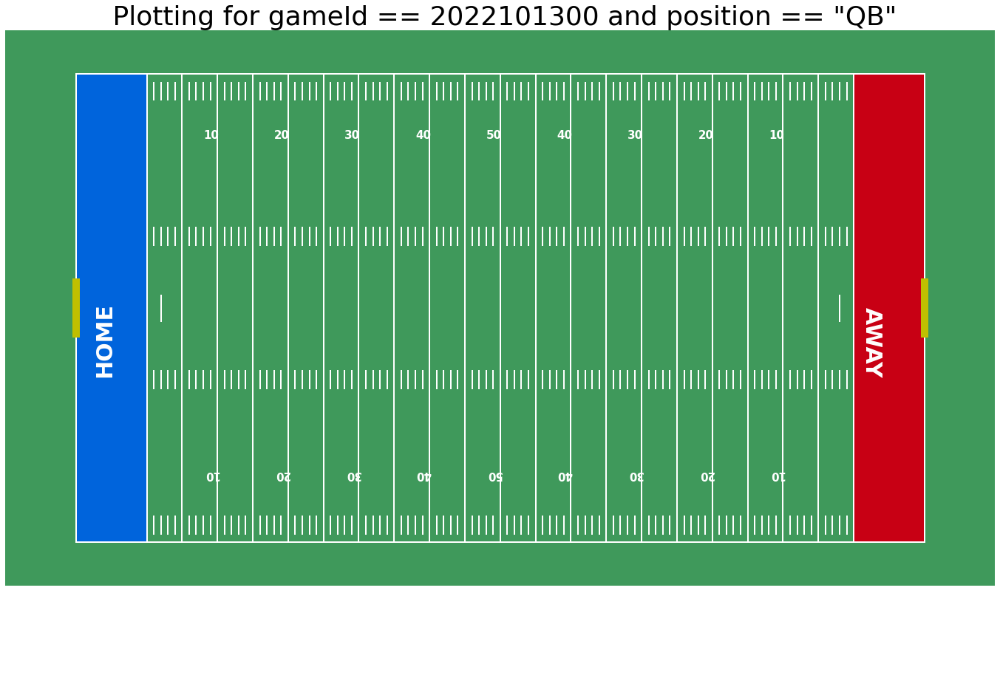

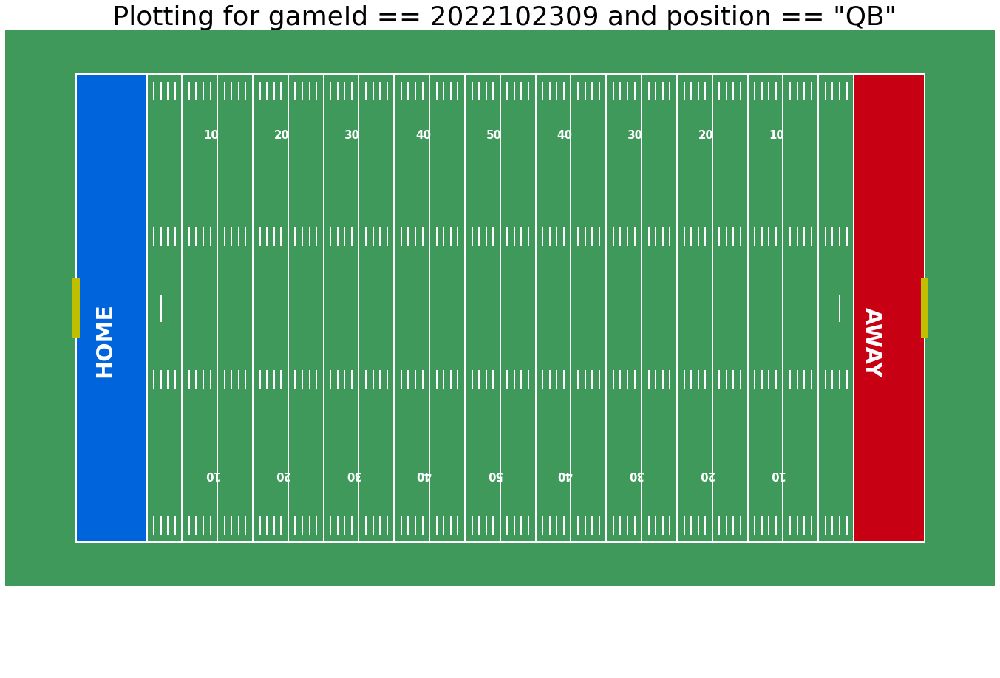

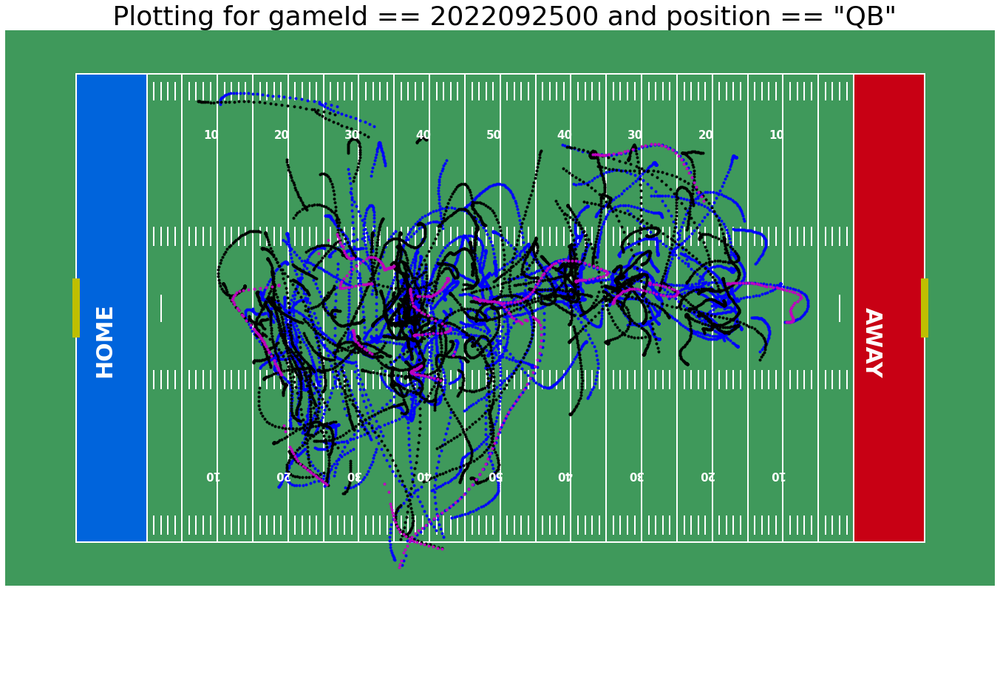

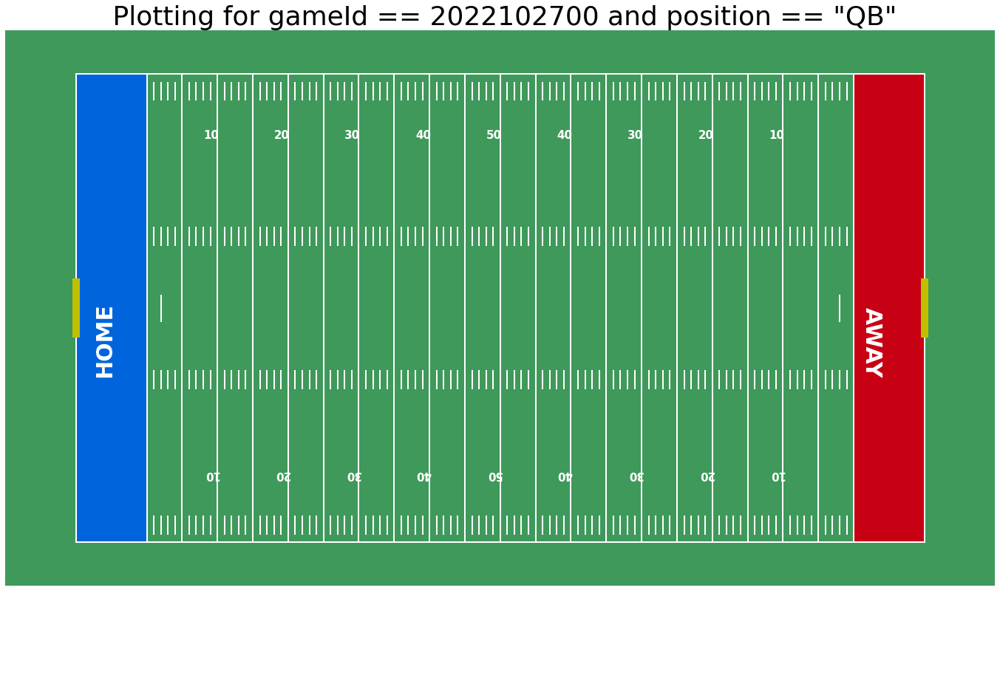

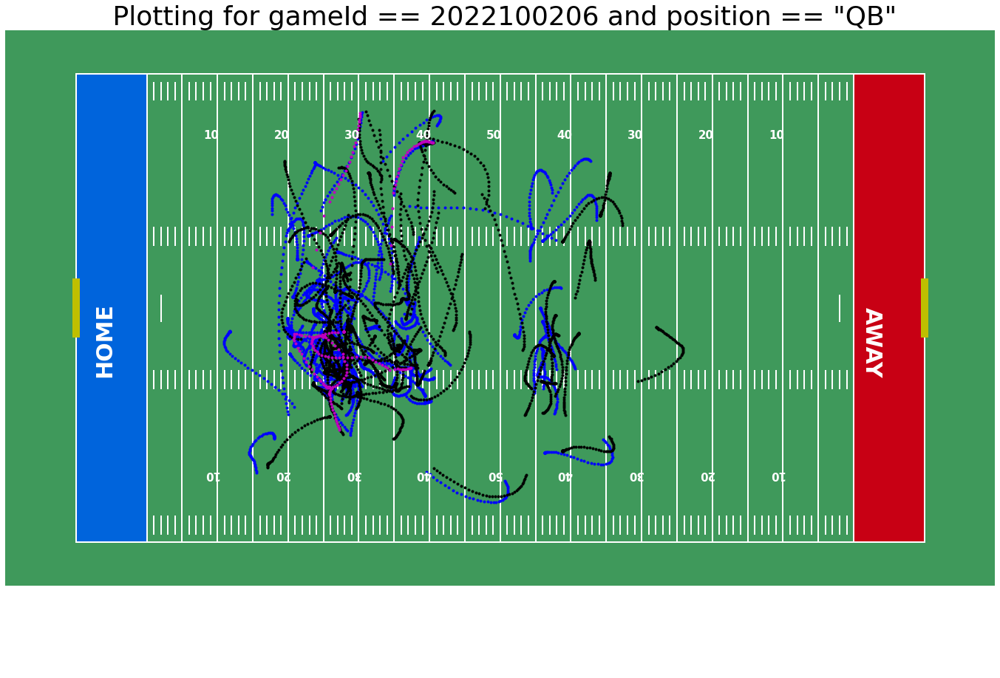

...

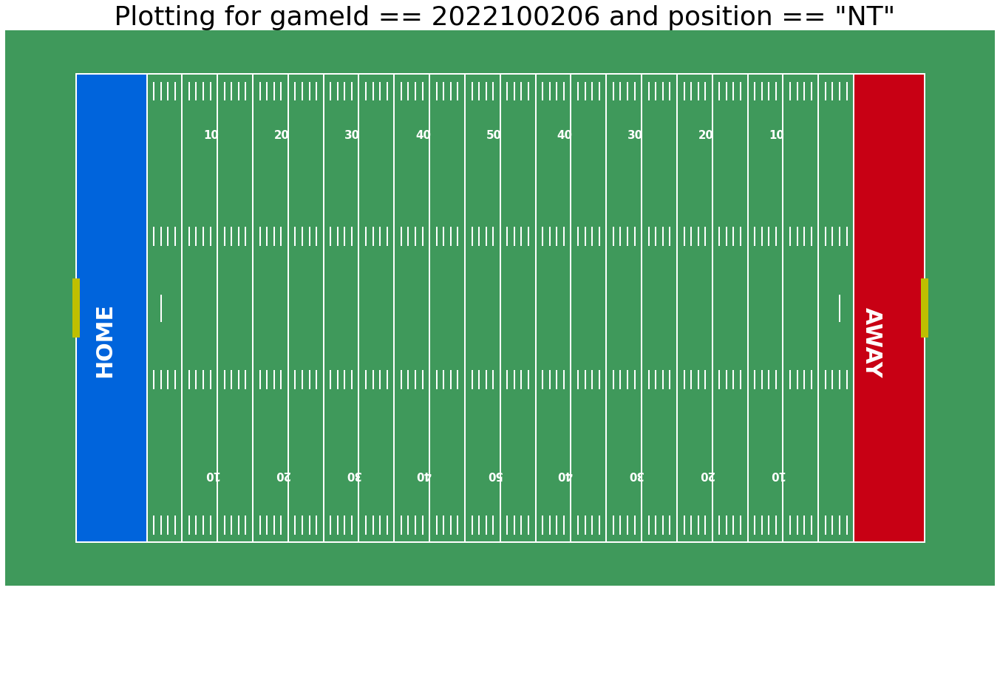

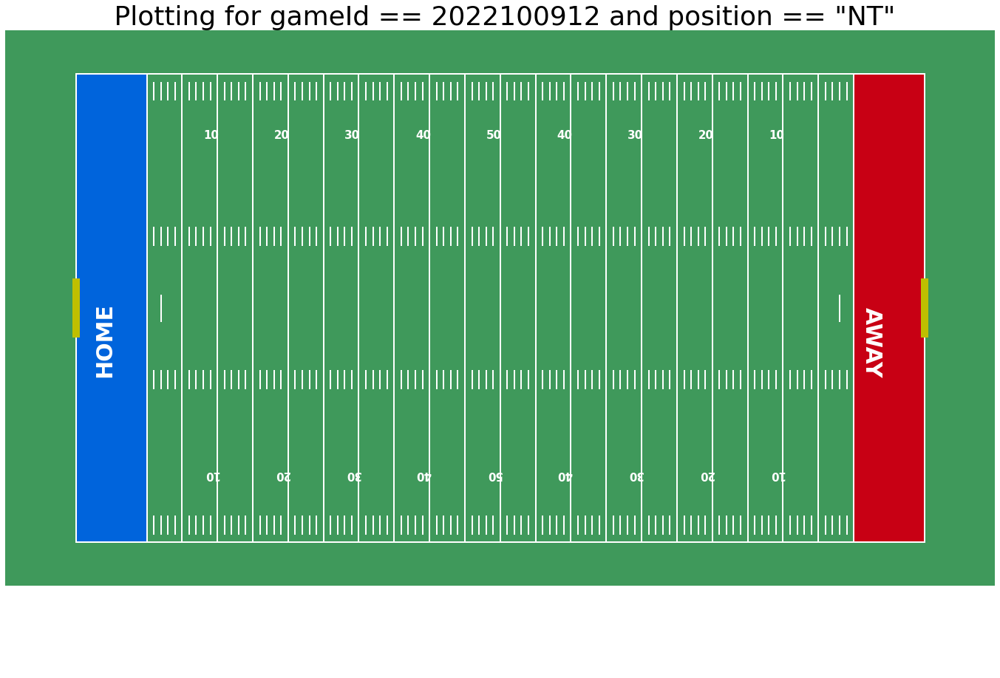

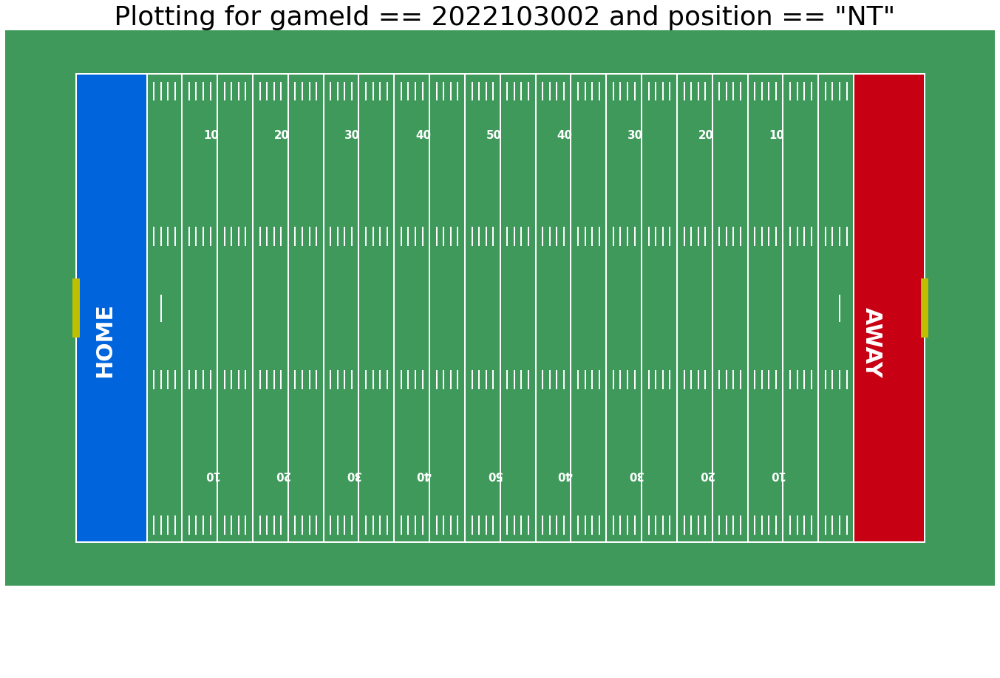

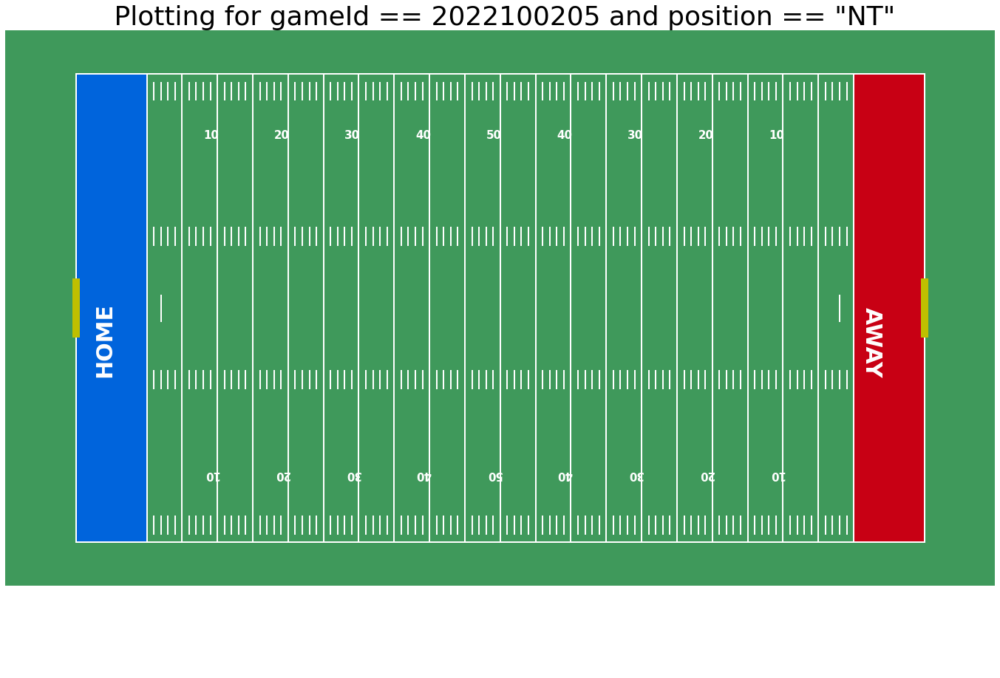

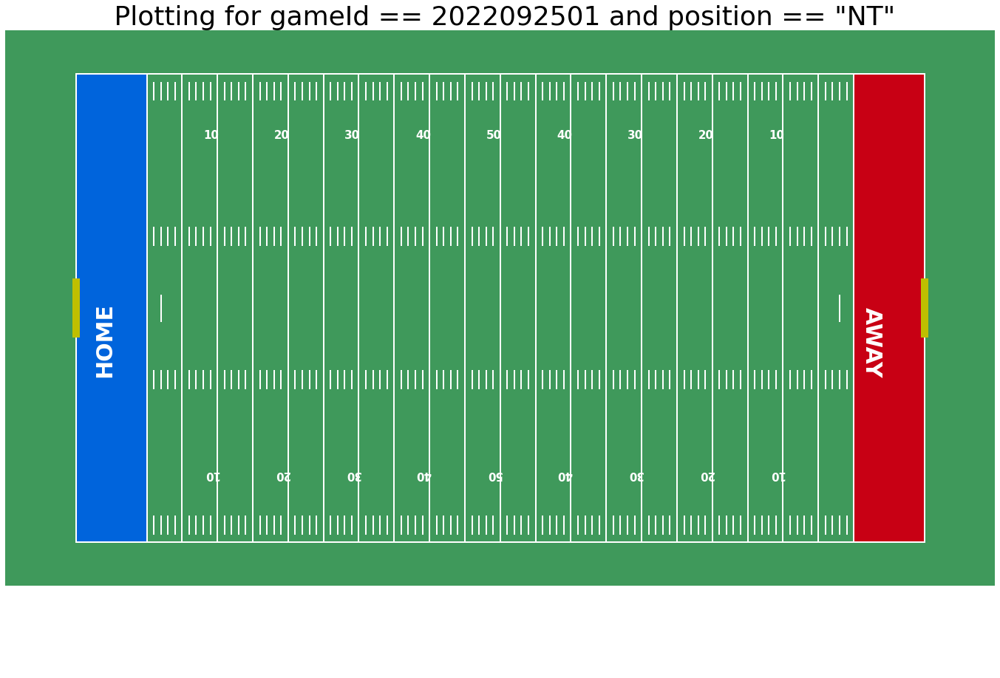

In [12]:
poslist = ["QB","OLB","WR","RB","TE","DT","ILB","C","DE","G","SS","T","NT"]
for position in poslist:
    print('Plotting for a ' + position + ' Postion performance')
    plot_play(tracking2024,'2022101300', position)
    plot_play(tracking2024,'2022102309', position)
    plot_play(tracking2024,'2022092500', position)
    plot_play(tracking2024,'2022102700', position)
    plot_play(tracking2024,'2022100206', position)
    plot_play(tracking2024,'2022100912', position)
    plot_play(tracking2024,'2022103002', position)
    plot_play(tracking2024,'2022100205', position)
    plot_play(tracking2024,'2022092501', position)

# Pull down

## Build the Game and Play Dataframes

In [13]:
games_ids = {}
games_tracking2024 = tracking2024.groupby(by=["gameId"])
#games_tracking2024 = tracking2024.groupby(by=["playId"])
for game, data in games_tracking2024:
    games_ids[game] = list(set(data.playId.tolist()))

#print(games_tracking2024.head(20))

## Define the Animation

In [14]:

def extract_one_game(game_id, play_id, df):
    game = df[(df.gameId == game_id) & (df.playId == play_id)]
    home = {}
    away = {}
    balls = []
    
    players = game.sort_values(['frameId'], ascending=True).groupby('nflId')
    for id, dx in players:
        jerseyNumber = int(dx.jerseyNumber.iloc[0])
        if dx.team.iloc[0] == "home":
            home[jerseyNumber] = list(zip(dx.x.tolist(), dx.y.tolist()))
        elif dx.team.iloc[0] == "away":
            away[jerseyNumber] = list(zip(dx.x.tolist(), dx.y.tolist()))


    ball_df = game.sort_values(['frameId'], ascending=True) 
    ball_df = ball_df[ball_df.club == "football"]
    balls = list(zip(ball_df.x.tolist(), ball_df.y.tolist()))
    return home, away, balls

# Animate One Play

In [15]:
from matplotlib import animation
from IPython.display import HTML
def animate_one_play(game_id, play_id, df):
    fig, ax = drawPitch(100, 53.3)
    
    home, away, balls = extract_one_game(game_id, play_id, df)

    team_left, = ax.plot([], [], '>', markersize=15, markerfacecolor="r", markeredgewidth=2, markeredgecolor="white", zorder=7)
    team_right, = ax.plot([], [], '<', markersize=15, markerfacecolor="b", markeredgewidth=2, markeredgecolor="white", zorder=7)
    ball, = ax.plot([], [], 'o', markersize=20, markerfacecolor="black", markeredgewidth=2, markeredgecolor="white", zorder=7)
    drawings = [team_left, team_right, ball]

    def init():
        team_left.set_data([], [])
        team_right.set_data([], [])
        ball.set_data([], [])
        return drawings

    def draw_teams(i):
        X = []
        Y = []
        for k, v in home.items():
            x, y = v[i]
            X.append(x)
            Y.append(y)
        team_left.set_data(X, Y)
        
        X = []
        Y = []
        for k, v in away.items():
            x, y = v[i]
            X.append(x)
            Y.append(y)
        team_right.set_data(X, Y)

    def animate(i):
        draw_teams(i)
        
        x, y = balls[i]
        ball.set_data([x, y])
        return drawings
    
    # !May take a while!
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(balls), interval=100, blit=True)

    return HTML(anim.to_html5_video())

## Import Animation Libraries

In [16]:
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt 

# for mpl animation
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='html5')


## Define Functions

In [17]:
def get_play_by_frame(fid, ax, los, one_play):
  """
  take one frame from one play, plot a scatter plot image  

  inputs:
    fid: frame ID  
    ax: current matplotlib ax  
    los: line of scrimmage (for aesthetics)  
    one_play: pandas dataframe for one play  

  output:
    seaborn axis level scatter plot  
  """
  # clear current axis (or else you'll have a tracer effect)
  ax.cla()

  # get game and play IDs
  gid = one_play['gameId'].unique()[0]
  pid = one_play['playId'].unique()[0]

  # isolates a given frame within one play
  one_frame = one_play.loc[one_play['frameId']==fid]

  # create a scatter plot, hard coded dot size to 100 
  fig1 = sns.scatterplot(x='x',y='y',data=one_frame, 
                         hue='club', ax=ax, s=100)
  
  # plots line of scrimmage 
  fig1.axvline(los, c='k', ls=':')

  # plots a simple end zone 
  fig1.axvline(0, c='k', ls='-')
  fig1.axvline(100, c='k', ls='-')

  # game and play IDs as the title
  fig1.set_title(f"game {gid} play {pid}")

  # takes out the legend (if you leave this, you'll get an annoying legend)
  fig1.legend([]).set_visible(False)

  # takes out the left, top, and right borders on the graph 
  sns.despine(left=True)

  # no y axis label
  fig1.set_ylabel('')

  # no y axis tick marks
  fig1.set_yticks([])

  # set the x and y graph limits to the entire field (from kaggle BDB page)
  fig1.set_xlim(-10,110)    
  fig1.set_ylim(0,54) 

def animate_play(one_play):    
  """
  animate a given NFL play from the BDB  

  inputs: 
    one_play: one play from the BDB data. you will want to 
      filter your dataset using gameId and playId.

  output: 
    animated gif, saved to your current working directory 

  """
  # get game and play IDs
  #from cycler import cycler
  #custom_cycler = (cycler(color=['b','k','m','g']))
    
  gid = one_play['gameId'].unique()[0]
  pid = one_play['playId'].unique()[0]

  # get line of scrimmage info from the football X location from the  first frame of data 
  los = one_play.loc[(one_play['frameId']==1) & (one_play['club']=='football'), 'x'].values[0]

  # set figure size; this is hard coded but seemed to work well  
  fig = plt.figure(figsize=(14.4, 6.4))
  #fig, ax = drawPitch(66, 36)
  #ax.set_prop_cycle(custom_cycler)
  #home, away, balls = extract_one_game(gid, pid, one_play)

  # get current axis of the figure
  ax = fig.gca()

  # matplotlib animate function
  # relies on get_play_by_frame()  
  # `interval = 100` is something like frames per second i think 
  # repeat=True is to have the animation continuously repeat  
  ani = animation.FuncAnimation(fig, get_play_by_frame, 
                                frames=one_play['frameId'].unique().shape[0],
                                interval=100, repeat=True, 
                                fargs=(ax,los,one_play,))
  
  # close the matplotlib figure when done (if you're batch processing gifs, this allows you to end one gif and begin another gif of a play)
  plt.close()

  # save the matplotlib animation as a gif
  # requires imagemagick or some sort of gif renderer
  # this works in google colab if you apt install imagemagick
  ani.save(f'{gid}_{pid}.gif', writer='imagemagick', fps=10)
  return ani   

In [18]:
data = tracking2024

In [19]:
def animate_plot(gameId, playId,data):
    play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
    play.shape
    animate_play(play)

In [20]:
gameId = 2022101300
playId = 826
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [21]:
gameId = 2022102309
playId = 3809
   
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [22]:
gameId = 2022092500
playId = 3674
   
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [23]:

gameId = 2022091800
playId = 2801
   
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [24]:
gameId = 2022102700
playId = 1224
   
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [25]:
gameId = 2022100912
playId = 1323    
   
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [26]:
gameId = 2022090800
playId = 56
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [27]:
gameId = 2022091100
playId = 546
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [28]:
gameId = 2022091108
playId = 1948
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>

In [29]:
gameId = 2022091105
playId = 4905
play = data.loc[(data['gameId']==gameId) & (data['playId']==playId)]
play.shape
animate_play(play)

<Figure size 1728x1152 with 0 Axes>